Basic Imports

In [19]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

Descriptive Statistics

In [20]:
df = pd.read_csv("london_fire_brigade_service_calls.csv")
print(lfb.head())

           address_qualifier date_of_call  easting_rounded  \
0       Within same building   2017-01-20           529450   
1       Within same building   2017-04-21           539650   
2  Correct incident location   2017-01-20           536950   
3       Within same building   2017-03-07           516650   
4  Correct incident location   2017-02-04           524250   

   first_pump_arriving_attendance_time  \
0                                359.0   
1                                211.0   
2                                  NaN   
3                                295.0   
4                                533.0   

  first_pump_arriving_deployed_from_station     frs  hour_of_call  \
0                                    Euston  London             8   
1                                 Stratford  London            17   
2                                       NaN  London            18   
3                                    Ealing  London            11   
4                            

In [21]:
print("Dataset Info:")
print(df.info())

Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32247 entries, 0 to 32246
Data columns (total 32 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   address_qualifier                           32247 non-null  object 
 1   borough_code                                32247 non-null  object 
 2   borough_name                                32247 non-null  object 
 3   cal_year                                    32247 non-null  int64  
 4   date_of_call                                32247 non-null  object 
 5   easting_m                                   16836 non-null  float64
 6   easting_rounded                             32247 non-null  int64  
 7   first_pump_arriving_attendance_time         30428 non-null  float64
 8   first_pump_arriving_deployed_from_station   30428 non-null  object 
 9   frs                                         32247 non-null  object 
 

In [22]:
print(df.describe())

       cal_year      easting_m  easting_rounded  \
count   32247.0   16836.000000     32247.000000   
mean     2017.0  530667.828582    530641.174373   
std         0.0   10436.093085      9855.434367   
min      2017.0  493654.000000    492450.000000   
25%      2017.0  525061.000000    525150.000000   
50%      2017.0  530716.000000    530850.000000   
75%      2017.0  536994.500000    536450.000000   
max      2017.0  560804.000000    563150.000000   

       first_pump_arriving_attendance_time  hour_of_call     northing_m  \
count                         30428.000000  32247.000000   16836.000000   
mean                            318.230380     13.465222  180366.958363   
std                             136.384571      6.152739    7534.304839   
min                               2.000000      0.000000  152868.000000   
25%                             232.000000      9.000000  175863.000000   
50%                             298.000000     14.000000  180962.000000   
75%            

In [23]:
print("Missing Values:")
print(df.isnull().sum())

Missing Values:
address_qualifier                                 0
borough_code                                      0
borough_name                                      0
cal_year                                          0
date_of_call                                      0
easting_m                                     15411
easting_rounded                                   0
first_pump_arriving_attendance_time            1819
first_pump_arriving_deployed_from_station      1819
frs                                               0
hour_of_call                                      0
incident_group                                    0
incident_number                                   0
incident_station_ground                           0
northing_m                                    15411
northing_rounded                                  0
num_pumps_attending                              68
num_stations_with_pumps_attending                68
postcode_district                               

In [24]:
df.describe(include=['object', 'category'])

,address_qualifier,borough_code,borough_name,date_of_call,first_pump_arriving_deployed_from_station,frs,incident_group,incident_number,incident_station_ground,postcode_district,...,property_category,property_type,second_pump_arriving_deployed_from_station,special_service_type,stop_code_description,time_of_call,timestamp_of_call,ward_code,ward_name,ward_name_new
count,32247,32247,32247,32247,30428,32247,32247,32247,32247,32247,...,32247,32247,11966,10081,32247,32247,32247,32247,32247,32247
unique,11,34,34,120,103,2,3,32247,103,318,...,9,260,102,21,9,26274,32236,655,631,631
top,Correct incident location,E09000033,WESTMINSTER,2017-02-23,Soho,London,False Alarm,008148-20012017,Soho,CR0,...,Dwelling,Purpose Built Flats/Maisonettes - 4 to 9 storeys,Soho,Flooding,AFA,18:03:40,2017-03-14 10:57:56,E05000649,WEST END,WEST END
freq,19267,2469,2469,525,1205,32078,15732,1,1247,612,...,15240,3823,375,2061,11811,6,2,623,623,623


From the above data we can already see that the ward_name and ward_name_new columns look extremely similar. Let's check

In [25]:
(df["ward_name"] == df["ward_name_new"]).all()

True

Since it's the same, we can delete one. We can also see that cal_year has a five number summary of 2017 and a std of 0, which means that it only has the value 2017 in it. This column does not provide any valuable insights for our model, there is no information gain, so we can safely delete it.

According to [https://www.llanellich.org.uk/] The UK Ordnance Survey grid is a grid of 100 kilometre squares with a true origin at 49° North and 2° West.  

Eastings: How far east (right) a point is from the origin (measured in meters) - easting_m  
Northings: How far north (up) a point is from the origin (measured in meters) - northing_m  

 Since we have two columns with no missing values rounded to 50 meters, namely easting_rounded and northing rounded, we can use these columns for our analysis and modelling instead of the original columns. The problem we are exploring does not explore effects of precise distances, like in the case of routing. Deleting these two columns as well.

In [26]:
df.drop(columns=["ward_name_new", "cal_year", "easting_m", "northing_m"], inplace=True)

borough_code, borough_name and proper_case are all indicators of the borough of each request. This creates redundancy, so it is better to just have one. Let's see if both the borough_name and proper_case are identical first.

In [27]:
(df['borough_name'].str.lower().eq(df['proper_case'].str.lower())).all()


True

I will drop both borough_code and borough_name and rename proper_case to borough_name because it looks cleaner. I am also removing incident number since it has no predictive power.

In [28]:
df.drop(columns=["borough_code", "borough_name", "incident_number"], inplace=True)
df.rename(columns={"proper_case": "borough_name"}, inplace=True)

By looking at a few records in incident_group and stop_code_description, we can see a lot of similar categorical variables, so it is possible that incident_group is a higher level abstraction of stop_code_description. This causes feature redundancy and it is better to just keep the more granular one(stop_code_description). To confirm the relationship we can check if stop_code_description fits within incident_group.

In [29]:
df.groupby("stop_code_description")["incident_group"].nunique()

stop_code_description
AFA                                      1
Chimney Fire                             1
False alarm - Good intent                1
False alarm - Malicious                  1
Flood call attended - Batch mobilised    1
Late Call                                1
Primary Fire                             1
Secondary Fire                           1
Special Service                          1
Name: incident_group, dtype: int64

Since there is exactly one incident group that corresponds to each stop code, we can confirm the relationship and safely remove incident group. For future reference, we need to be careful with stop_code_description since it depends on the outcome, not on information known at the time of dispatch. The value is updated only after the incident is handled, which makes our model susceptible to target leakage.

In [30]:
df.drop(columns=["incident_group"], inplace=True)

In [31]:
import geopandas as gpd
import pandas as pd
import numpy as np
import seaborn as sns
from tabulate import tabulate

Bradley- 
It seems as though easting_m, first_pump_arriving_attendance_time, first_pump_arriving_deployed_from_station, northing_m, num_pumps_attending, num_stations_with_pumps_attending, postcode_full

In [32]:
#Bradley- 
#checking for missing values within each column in my dataset
# percentage of missing values in each column
missing_values = df.isnull().mean() * 100
print("\nPercentage of missing values in each column:")
display(missing_values[missing_values > 0])


Percentage of missing values in each column:


first_pump_arriving_attendance_time            5.640835
first_pump_arriving_deployed_from_station      5.640835
num_pumps_attending                            0.210872
num_stations_with_pumps_attending              0.210872
postcode_full                                 47.790492
second_pump_arriving_attendance_time          62.892672
second_pump_arriving_deployed_from_station    62.892672
special_service_type                          68.738177
dtype: float64

Bradley- 
The missing values for second pump data are not random - they represent situations where only one pump was needed. This is valuable information about incident severity

Bradley- 
The missingness itself is informative for the second pump columns - it tells us that the incident only required one pump, which indicates lower severity. By creating a feature that captures this information, you preserve the relationship between incident severity and response requirements.

Bradley- 
# I Created a binary feature showing whether a second pump was deployed
df['second_pump_deployed'] = df['second_pump_arriving_attendance_time'].notna().astype(int)

 Bradley- 
 NaN's were left and not removed, reason for this is: To keep the missing values as is and use methods that can handle NaN values. This is the most accurate representation since there genuinely was no "time between pumps" for single-pump incidents.

In [33]:
#Bradley- 
# I created another feature showing the time between the first and second pump arriving at the scene in seconds
df['time_between_pumps'] = df['second_pump_arriving_attendance_time'] - df['first_pump_arriving_attendance_time']

#Bradley- 
Missing values for second_pump_arriving_deployed_from_station, if the values were missing this was because there was no second pump, I done this in order to preserve missingness information for second pump arrival.

In [34]:
#Bradley- 
# Created a categorical feature that preserves the "missingness" information for second pump arriving
df['second_pump_arriving_deployed_from_station'] = df['second_pump_arriving_deployed_from_station'].fillna('No_Station')

In [35]:
#Bradley- 
print(tabulate(df, headers='keys', tablefmt='psql')) 

+-------+-------------------------------------------------+----------------+-------------------+---------------------------------------+---------------------------------------------+---------------+----------------+---------------------------+--------------------+-----------------------+-------------------------------------+---------------------+-----------------+------------------------+---------------------+--------------------------------------------------------------------------------+----------------------------------------+----------------------------------------------+---------------------------------+---------------------------------------+----------------+---------------------+-------------+--------------------------------------+----------------------+
|       | address_qualifier                               | date_of_call   |   easting_rounded |   first_pump_arriving_attendance_time | first_pump_arriving_deployed_from_station   | frs           |   hour_of_call | incident_sta

In [37]:
#Bradley- 
# Renamed the rounded columns to make it clear they're the primary coordinates
df.rename(columns={
    'easting_rounded': 'easting_m',
    'northing_rounded': 'northing_m'
}, inplace=True)

Bradley- 
The rows containing 'Nan' values for first_pump_arriving_attendence_time were removed this is because we coudn't make sense of why the values were missing, and also the num_pumps_attending column still containted values, however no pumps were deployed so we couldnt figure out why this was case

 how can pumps be counted as attending if there's no record of their arrival time?

There are several possible explanations for this inconsistency:
- Data recording errors.
- Incidents where pumps were dispatched but then recalled before arriving.
- Special administrative cases where pumps were "assigned" but didn't physically respond.
- Incidents that were handed off to other agencies.

In [38]:
#Bradley- 
missing_first_pump = df[df['first_pump_arriving_attendance_time'].isnull()]

print(tabulate(missing_first_pump, headers='keys', tablefmt='psql')) 

+-------+-------------------------------------------------+----------------+-------------+---------------------------------------+---------------------------------------------+---------------+----------------+---------------------------+--------------+-----------------------+-------------------------------------+---------------------+-----------------+------------------------+---------------------+--------------------------------------------------------+----------------------------------------+----------------------------------------------+---------------------------------+---------------------------------------+----------------+---------------------+-------------+--------------------------------------+----------------------+
|       | address_qualifier                               | date_of_call   |   easting_m |   first_pump_arriving_attendance_time |   first_pump_arriving_deployed_from_station | frs           |   hour_of_call | incident_station_ground   |   northing_m |   num_pumps

In [40]:
#Bradley- 
missing_first_pump_percentage = (len(missing_first_pump) / len(df)) * 100
print(f"Percentage of missing values in 'first_pump_arriving_attendance_time': {missing_first_pump_percentage:.2f}%")


#  removing the rows with missing values in the first pump arriving attendance time column
df.dropna(subset=['first_pump_arriving_attendance_time'], inplace=True)

# displaying number of rows of the dataset
print(f"Number of rows after dropping missing values: {len(df)}")

Percentage of missing values in 'first_pump_arriving_attendance_time': 5.64%
Number of rows after dropping missing values: 30428


In [ ]:
# Calculate statistics
q1 = df['first_pump_arriving_attendance_time'].quantile(0.25)
q3 = df['first_pump_arriving_attendance_time'].quantile(0.75)
iqr = q3 - q1

# Define upper and lower bounds
upper_bound = q3 + 1.5 * iqr
lower_bound = q1 - 1.5 * iqr  
lower_bound = max(0, lower_bound) 

# Identify outliers
outliers = df[(df['first_pump_arriving_attendance_time'] > upper_bound) | 
              (df['first_pump_arriving_attendance_time'] < lower_bound)]

print(f"Number of outliers identified: {len(outliers)}")
print(f"Percentage of data: {len(outliers)/len(df)*100:.2f}%")

Number of outliers identified: 1261
Percentage of data: 4.14%


In [ ]:
# Applying capping to response times
df['first_pump_arriving_attendance_time_capped'] = df['first_pump_arriving_attendance_time'].clip(
    lower=lower_bound, 
    upper=upper_bound
)

In [ ]:
# showing that my capping worked
print(f"Original min: {df['first_pump_arriving_attendance_time'].min()}, max: {df['first_pump_arriving_attendance_time'].max()}")
print(f"Capped min: {df['first_pump_arriving_attendance_time_capped'].min()}, max: {df['first_pump_arriving_attendance_time_capped'].max()}")

Original min: 2.0, max: 1196.0
Capped min: 11.5, max: 599.5


Text(0, 0.5, 'Frequency')

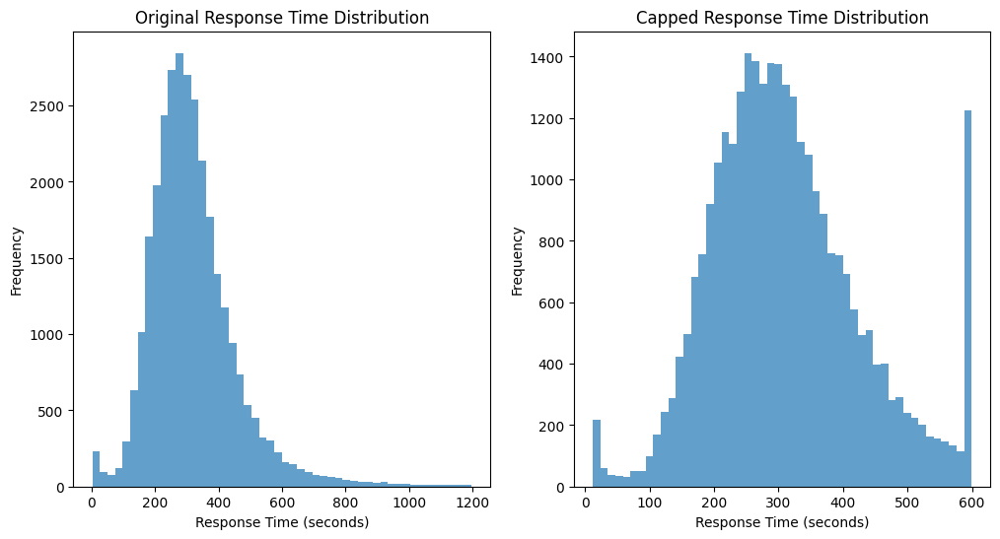

In [44]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.hist(df['first_pump_arriving_attendance_time'], bins=50, alpha=0.7)
plt.title('Original Response Time Distribution')
plt.xlabel('Response Time (seconds)')
plt.ylabel('Frequency')

plt.subplot(1, 2, 2)
plt.hist(df['first_pump_arriving_attendance_time_capped'], bins=50, alpha=0.7)
plt.title('Capped Response Time Distribution')
plt.xlabel('Response Time (seconds)')
plt.ylabel('Frequency')